In [8]:
import os
import re
import cv2
from cv2 import VideoCapture
import numpy as np
from tqdm.notebook import tqdm, trange
import matplotlib.pyplot as plt
from typing import List, Any, Union, Tuple
import os
import math


In [9]:
def video2frames(vid_path: str, save_path: str) -> None:
    """Convert videos to frame and save frames.

    Args:
        vid_path: path to video
        save_path: path to save frames to
    """
    assert save_path[-1] == "/", f"Requires a directory, {save_path} must end in '/'"
    if not os.path.exists(save_path):
        os.makedirs(save_path)

    vidcap = VideoCapture(vid_path)
    success, image = vidcap.read()
    count = 0
    while success:
        cv2.imwrite(save_path + f"{count}.jpg", image)  # save frame as JPEG file
        success, image = vidcap.read()
        count += 1
    print(f"Saved {count} frames to {save_path}.")
    vidcap.release()


# convert bfmc_2020 videos to frames
vid_paths = [
    # "./data/Records/bfmc2020_online_1.avi",
    "./data/RealTrackDemo.mp4",
    # "./data/Records/bfmc2020_online_1.avi",
]

paths = []
for i, v_path in enumerate(vid_paths):
    path = f"./data/RTD/" # edit this 
    paths.append(path)
    video2frames(v_path, path)


Saved 3657 frames to ./data/RTD/.


In [10]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [12]:
def import_images(path: str) -> List[np.ndarray]:
    """Import all the images of a given directory path and return an array of images

    Args:
        path:(str) path to dir (Make sure path ends in a /)

    Returns:List[np.ndarray] List of images.

    """
    assert path[-1] == "/", f"Requires a directory, {path} must end in a '/'"

    # get file names of frames
    col_frames = os.listdir(path)
    col_frames.sort(key=lambda f: int(re.sub("\D", "", f)))

    # load frames
    col_images = []
    for i in tqdm(col_frames):
        img = cv2.imread(path + i)
        col_images.append(img)
    return col_images


path = "./data/RTD/"
col_images = import_images(path)
len(col_images)

  0%|          | 0/3657 [00:00<?, ?it/s]

3657

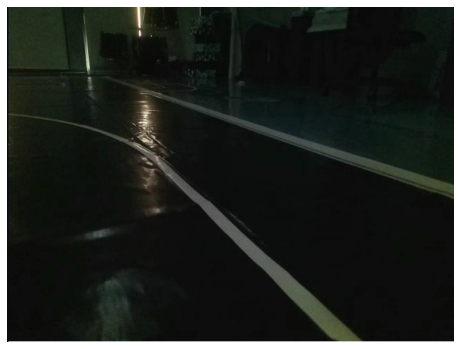

In [15]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(i)] for i in col_images[500:900:3]]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=100, blit=True)
# ani.save("outputanimation.mp4")
HTML(ani.to_jshtml())

In [16]:
from LaneFollowing import perspectiveWarp

[(0, 263.45000000000005), (639, 263.45000000000005), (0, 479), (639, 479)]


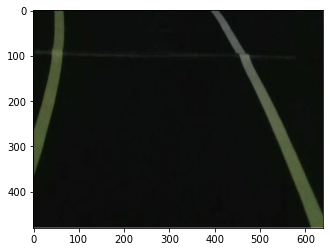

In [121]:
plt.imshow(perspectiveWarp(col_images[700],luroi=0,ruroi=1)[0])

In [132]:
img_=perspectiveWarp(col_images[700],luroi=0,ruroi=1)[0]
gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
hls = cv2.cvtColor(img_, cv2.COLOR_BGR2HLS)
# src = 0.6*hls_s + 0.4*gray

[(0, 263.45000000000005), (639, 263.45000000000005), (0, 479), (639, 479)]


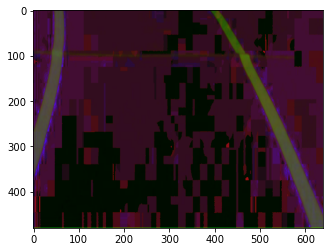

In [133]:
plt.imshow(hls)

In [134]:
white_lower = np.array([np.round(  0 / 2), np.round(0.15 * 255), np.round(0.00 * 255)])
white_upper = np.array([np.round(360 / 2), np.round(1.00 * 255), np.round(0.30 * 255)])
white_mask = cv2.inRange(hls, white_lower, white_upper)

# Yellow-ish areas in image
# H value must be appropriate (see HSL color space), e.g. within [40 ... 60]
# L value can be arbitrary (we want everything between bright and dark yellow), e.g. within [0.0 ... 1.0]
# S value must be above some threshold (we want at least some saturation), e.g. within [0.35 ... 1.0]
yellow_lower = np.array([np.round( 40 / 2), np.round(0.00 * 255), np.round(0.35 * 255)])
yellow_upper = np.array([np.round( 60 / 2), np.round(1.00 * 255), np.round(1.00 * 255)])
yellow_mask = cv2.inRange(hls, yellow_lower, yellow_upper)

# Calculate combined mask, and masked image
mask = cv2.bitwise_or(yellow_mask, white_mask)
masked = cv2.bitwise_and(img_, img_, mask = mask)

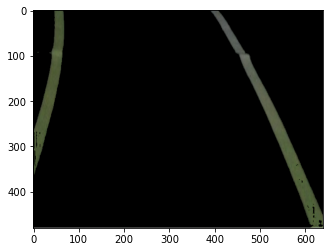

In [135]:
plt.imshow(masked)